<center><img src="https://github.com/hse-ds/iad-applied-ds/blob/master/2021/hw/hw1/img/logo_hse.png?raw=1" width="1000"></center>

<h1><center>Прикладные задачи анализа данных</center></h1>
<h2><center>Домашнее задание 3: прогнозирование временных рядов</center></h2>

**Мягкий дедлайн:** 23:59MSK 19.05.2024

**Жесткий дедлайн:** 23:59MSK 26.05.2024

In [3]:
!pip install -r requirements.txt

In [4]:
import warnings
import gdown
import pandas as pd
import numpy as np
from copy import deepcopy

warnings.filterwarnings("ignore")

В данной задаче мы будем решать одну из актуальных практических задач, с которыми, в том числе, сталкиваются разработчики ETNA - прогнозирование объема необходимой наличности в банкоматах. Пожалуй, ни для кого не секрет, что отсутствие необходимой суммы в банкомате не делает клиента банка счастливее. В то же время, избыток заправленной в банкомат наличности приводит к упущенной выгоде - ведь, в конечном счете, эти деньги могли быть размещены в качестве краткосрочного депозита на межбанковском рынке. Для кредитной организации с обширной сетью банкоматов даже незначительное улучшение качества предсказания способно внести значительный вклад в прибыльность этой ветки бизнеса.

В качестве инструмента воспользуемся библиотекой ETNA, документацию можно прочитать [тут](https://docs.etna.ai/stable/), и [чат](https://t.me/etna_support) комьюнити.

Мы будем использовать дневные данные реальных банкоматов для чего возьмем мультисегментный датасет.

In [5]:
url = 'https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv'
output = 'atms_daily_cash.csv'
gdown.download(url=url, output=output, quiet=False, fuzzy=True)

df = pd.read_csv('atms_daily_cash.csv', index_col=False)

Downloading...
From: https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv
To: /content/atms_daily_cash.csv
100%|██████████| 258k/258k [00:00<00:00, 2.99MB/s]


Полученные данные были просуммированы по банкоматам и дням эксплуатации, после чего залиты в gist, откуда мы и берем их.

Взглянем на то, что представляют из себя данные после этих действий:

In [3]:
df.head()

,datetime,atm_id,operation_value
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921


### Задание 1. EDA (1.75 балл)

Проведите разведывательный анализ данных с помощью `ETNA`- постройте графики, на которых можно судить о наличии тренда, сезонности и прочих зависимостей. Проанализируйте корреляции. Какие выводы вы можете сделать?

Ссылку на туториал по EDA можно найти [тут](https://docs.etna.ai/stable/tutorials/103-EDA.html#EDA).

In [6]:
from etna.datasets import TSDataset

In [7]:
df = df.rename(columns = {'datetime':'timestamp', 'atm_id':'segment', 'operation_value':'target'}) #Переименовываем все в нужный формат
df.segment.unique()

array([ 74,  85,  86,  87,  88,  90,  91,  93,  94,  96,  97,  98,  99,
       100, 101, 102, 103, 104, 105, 106])

In [45]:
#YOUR CODE HERE#
ts = TSDataset(df, freq="D") #У нас данные по дням, поэтому ставим D
ts.head(100)

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.235345,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-13.532317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-09-12,98.638823,-54.511703,34.625081,237.433326,178.656002,-81.517501,40.361606,159.269487,-71.956624,-12.767447,189.834872,77.840240,176.008374,338.837449,67.426240,19.239425,229.372772,94.637964,228.696156,40.273352
2017-09-13,57.718274,100.345072,94.579128,93.431823,7.119175,146.149023,101.845394,178.420657,461.040155,254.172214,-111.053253,133.381576,-75.280868,58.424307,100.139145,94.137857,132.822633,151.267769,56.100279,-71.986043


In [8]:
ts.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,3,20,0,0,0,D
101,2017-08-11,2018-09-30,416,3,20,0,0,0,D
102,2017-08-02,2018-09-30,425,3,20,0,0,0,D
103,2017-08-08,2018-09-30,419,3,20,0,0,0,D
104,2017-08-07,2018-09-30,420,3,20,0,0,0,D
105,2017-07-28,2018-09-30,430,3,20,0,0,0,D
106,2017-08-09,2018-09-30,418,3,20,0,0,0,D
74,2017-08-16,2018-09-30,411,3,20,0,0,0,D
85,2017-08-03,2018-09-30,424,3,20,0,0,0,D


In [12]:
segments1 = [ 74,  85,  86,  87,  88,  90,  91,  93,  94, 96] #Здесь разбиваю на 2 случая для построения всех графиков и тд
segments2 = [ 97,  98,  99, 100, 101, 102, 103, 104, 105, 106]
ts1 = TSDataset(df.loc[df['segment'].isin(segments1)], freq="D")
ts2 = TSDataset(df.loc[df['segment'].isin(segments2)], freq="D")

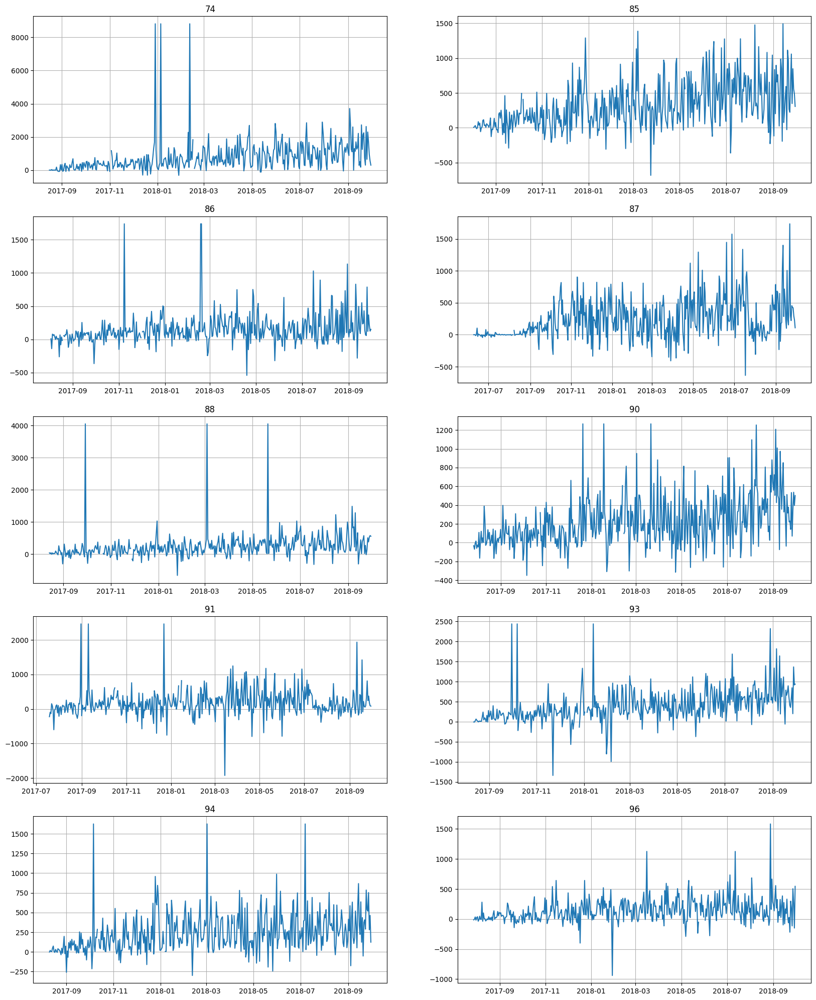

In [13]:
ts1.plot() #Возможно есть тренд возрастающий линейный + у некоторых колебания сильные

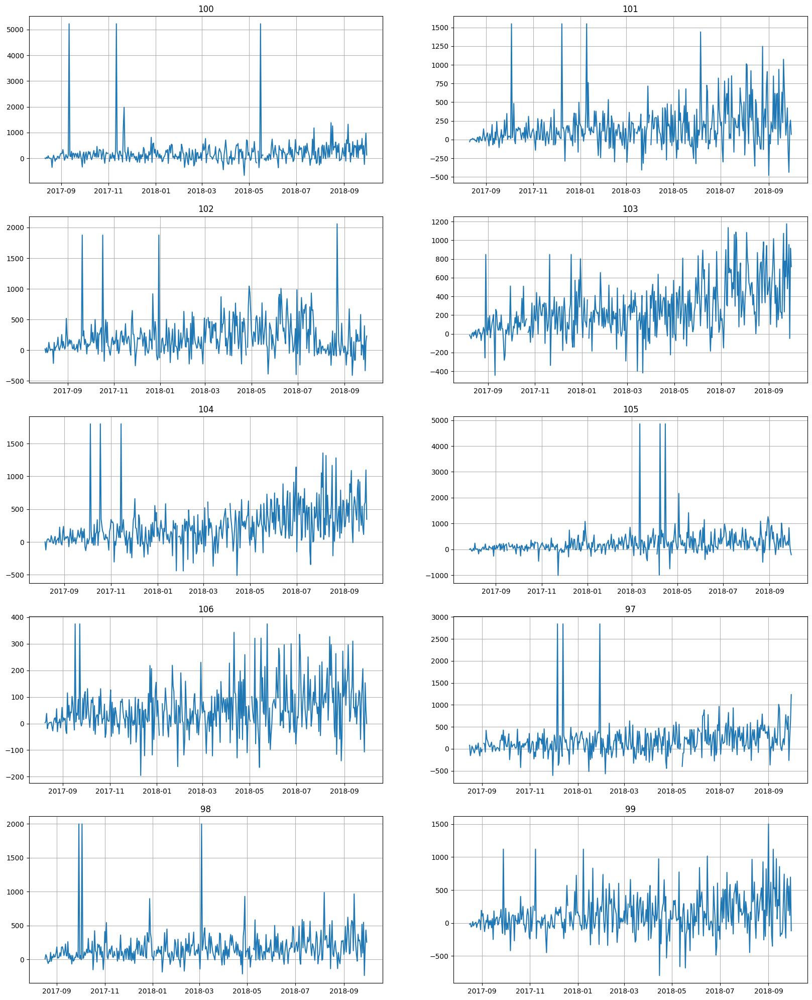

In [14]:
ts2.plot()

In [9]:
from etna.analysis import acf_plot
from etna.analysis import cross_corr_plot
from etna.analysis import distribution_plot
from etna.analysis import plot_correlation_matrix

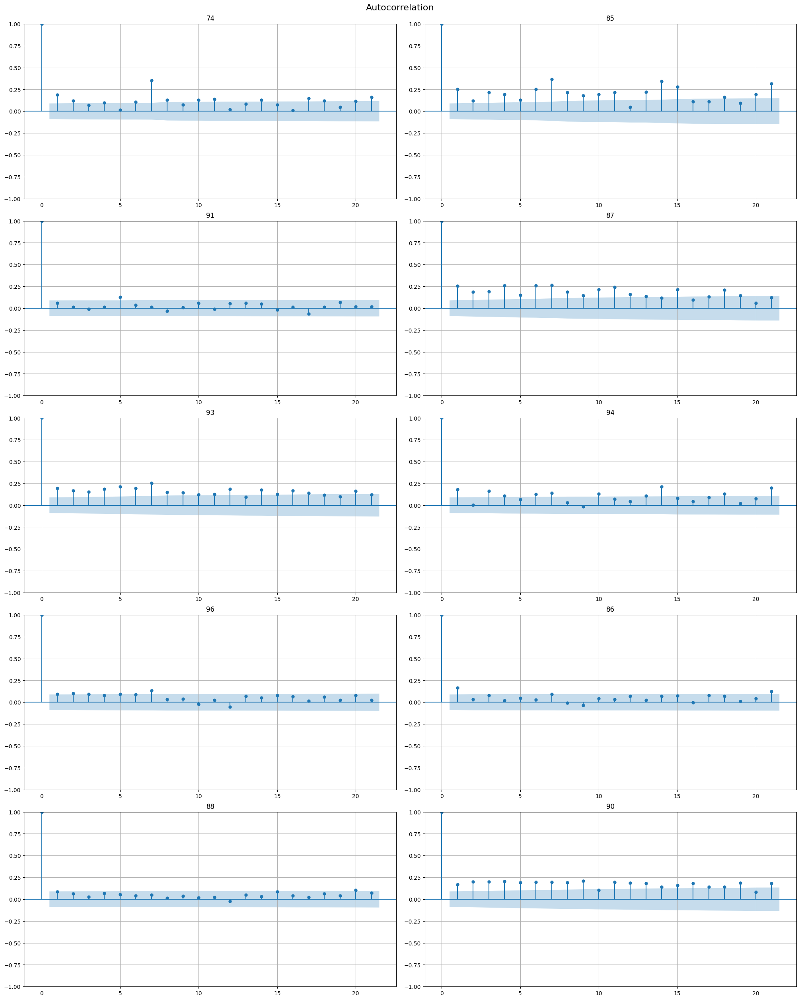

In [16]:
acf_plot(ts1, lags=21)

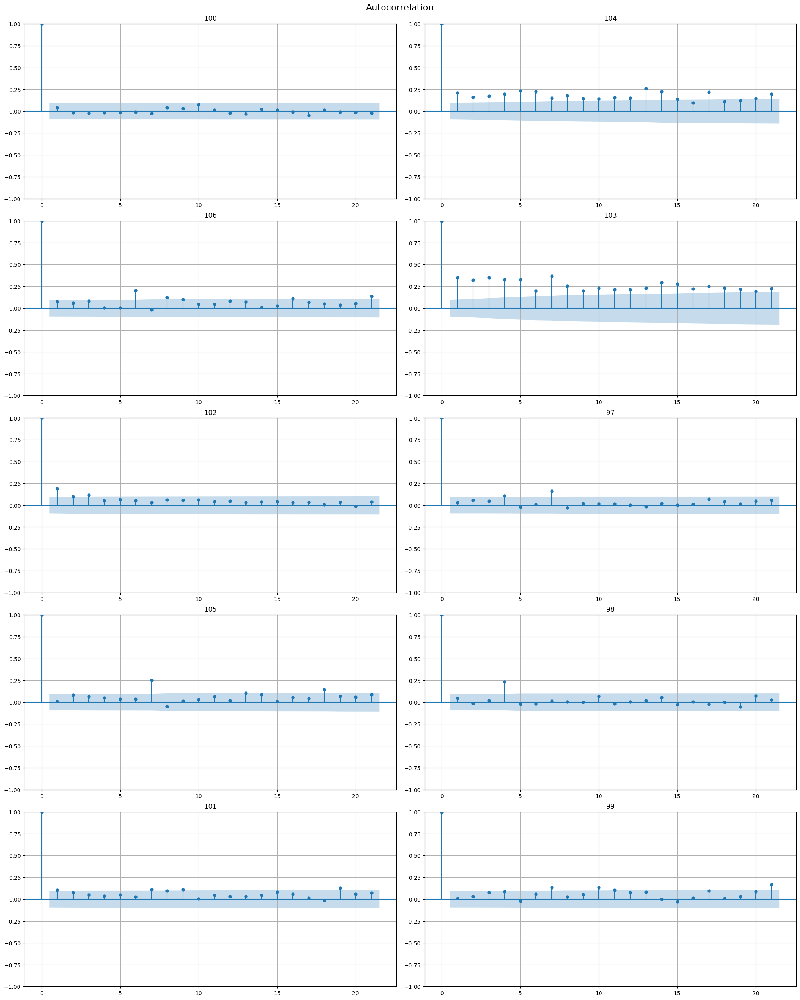

In [17]:
acf_plot(ts2, lags=21)

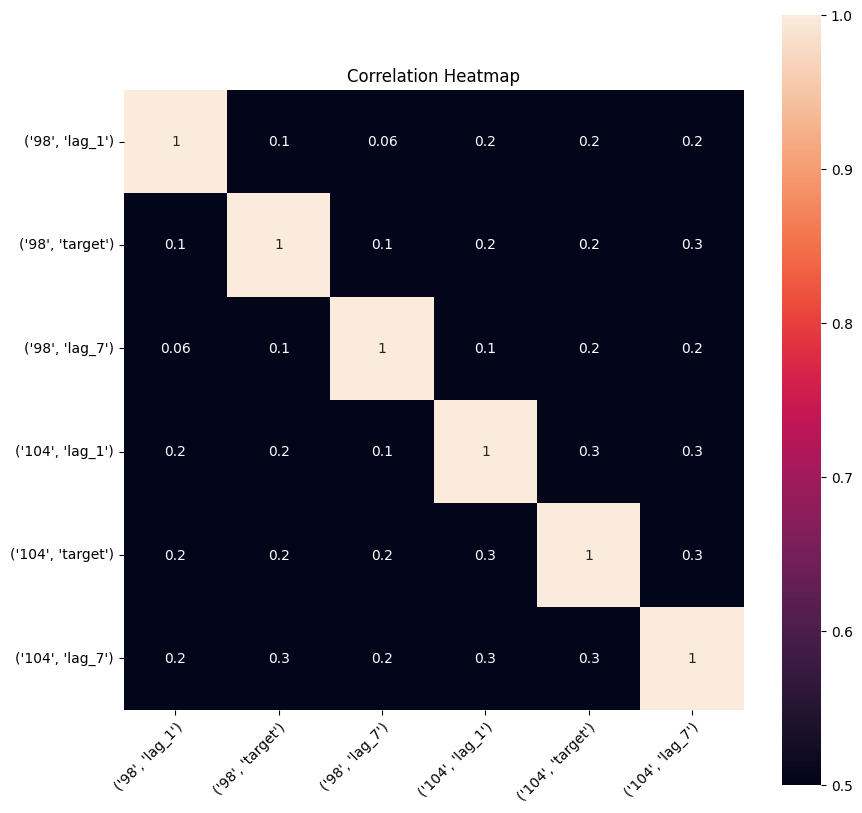

In [18]:
from etna.transforms import LagTransform
lags = LagTransform(in_column="target", lags=[1, 7], out_column="lag")
ts_tester = ts
ts_tester.fit_transform([lags])
plot_correlation_matrix(ts_tester, segments=["98", "104"], method="spearman", vmin=0.5, vmax=1)

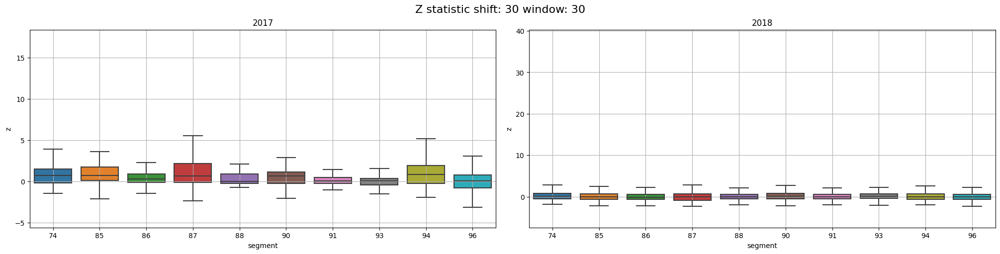

In [19]:
distribution_plot(ts1, freq="1Y")

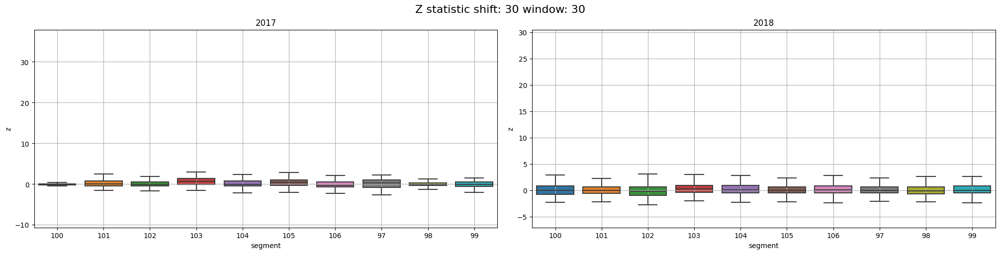

In [20]:
distribution_plot(ts2, freq="1Y")

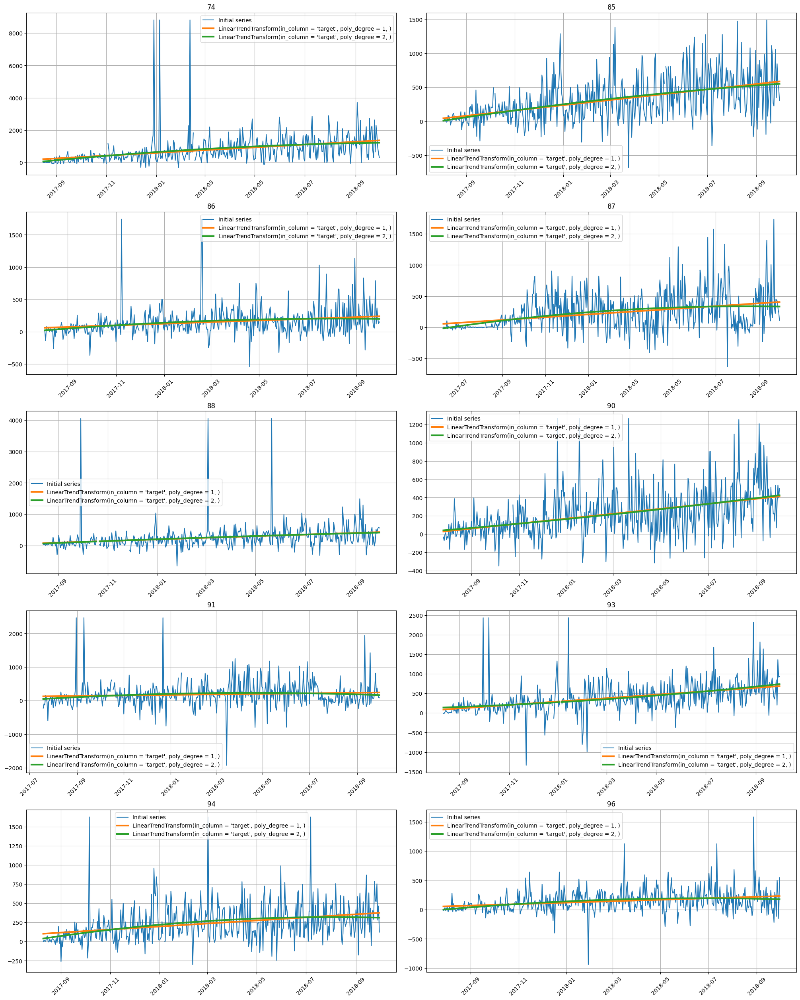

In [21]:
from etna.analysis import plot_trend
from etna.transforms import LinearTrendTransform
trends = [
    LinearTrendTransform(in_column="target", poly_degree=1),
    LinearTrendTransform(in_column="target", poly_degree=2),
]
plot_trend(ts1, trend_transform=trends)

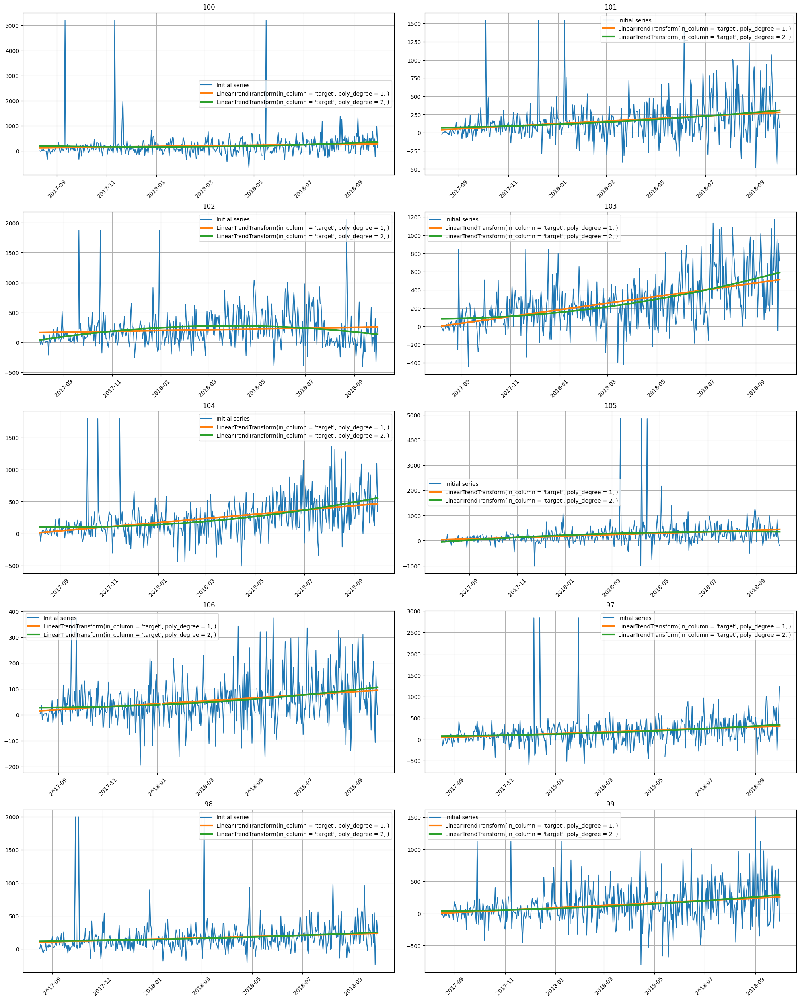

In [22]:
plot_trend(ts2, trend_transform=trends)

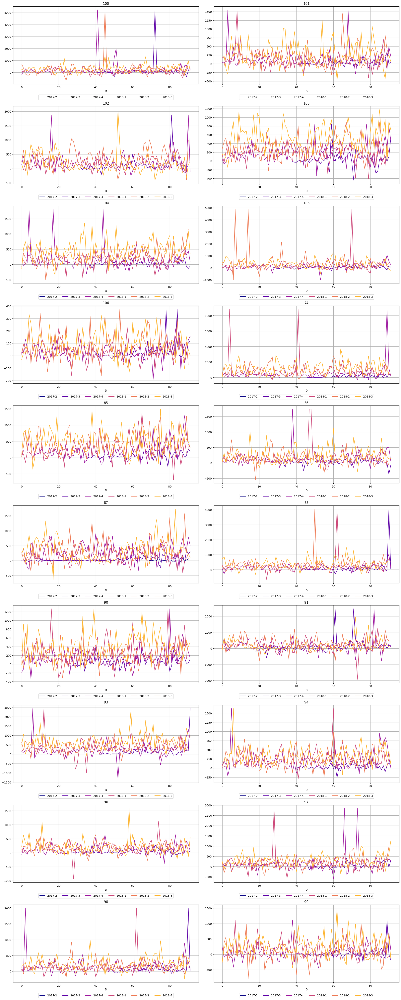

In [24]:
from etna.analysis import seasonal_plot
seasonal_plot(ts=ts, cycle="quarter")

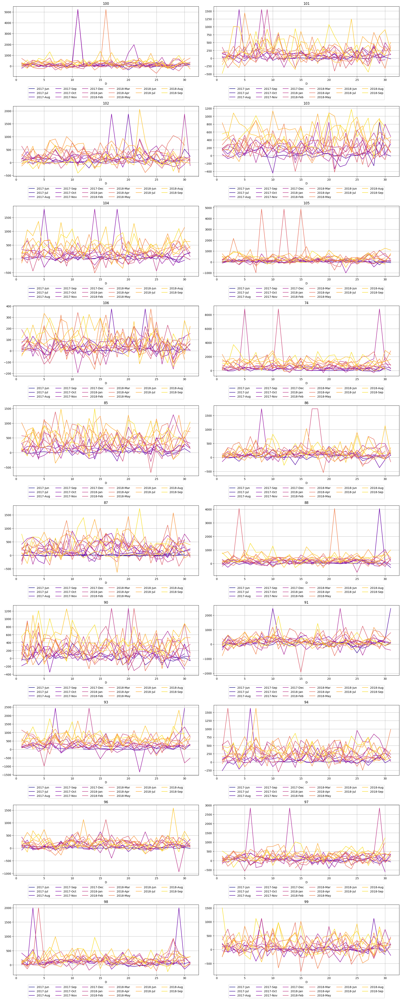

In [26]:
seasonal_plot(ts=ts, cycle="month")

Выводы: У нас разные длины рядов, то есть где-то есть пропуски и данные получены из разных временных промежутков. Из графиков можно увидеть достаточно сильные дневные колебания в данных, причем в некоторых банкоматах они прямо сильные, а в некоторых нет. Везде визуально есть возрастающий тренд. Также я построила графики автокорреляции для каждого банкомата. Можно заметить, что очень часто значимым является 7 лаг (например у сегментов 74, 85, 96, 103, 97, 105 и тд). Можно сделать вывод, что для многих сегментов значения временного ряда на 7 шагов назад имеют сильную корреляцию с текущими значениями. При этом у многих рядов почти все лаги значимы (например у 93, 90), то есть все значения имеют сильную корреляцию с текущими, а для некоторых наоборот, такой корреляции вообще нет (88 или 100 банкоматы). Ради интереса построила корреляционную тепловую матрицу для двух сегментов (98 и 104). Можно увидеть, что корреляции между лагами там нет (очень маленькие значения) -> значения одного банкомата в данном случае не взаимосвязаны со значениями другого.
Графики распределения говорят о том, что у нас данные изменяются с течением времени, в 18 году у некоторых сегментов упал разброс в данных. Также во всех сегментах виден линейный возрастающий тренд. В некоторых он не сильно ярко выражен (например сегмент 100), а в некоторых он отчетливо виден (сегмент 90). Сезонности по кварталам как-будто нет, по крайней мере визуально я не вижу каких-то закономерностей. Про месяца могу сказать то же самое, сезонности я не вижу, есть иногда повторяющиеся тенденции (например 98 банкомат), но не во всех сегментах.


### Задание 2. Работа с пропущенными значениями и выбросами (1 балл)

Проанализируйте, есть ли в данных пропущенные значения, и подберите оптимальный метод их заполнения средствами ETNA. Какие методы вы выберете и почему? Совет: возможно, лучше сохранить заполненные данные в отдельный объект, поскольку некоторые модели заполняют пропуски встроенными методами, и подача на вход "сырых" данных (на языке временных рядов это данные с нерегулярными интервалами) может принести лучший результат.

Импорты всех необходимых компонент произведите самостоятельно.

In [ ]:
#Вот по этой статье делала https://habr.com/ru/companies/tinkoff/articles/677186/

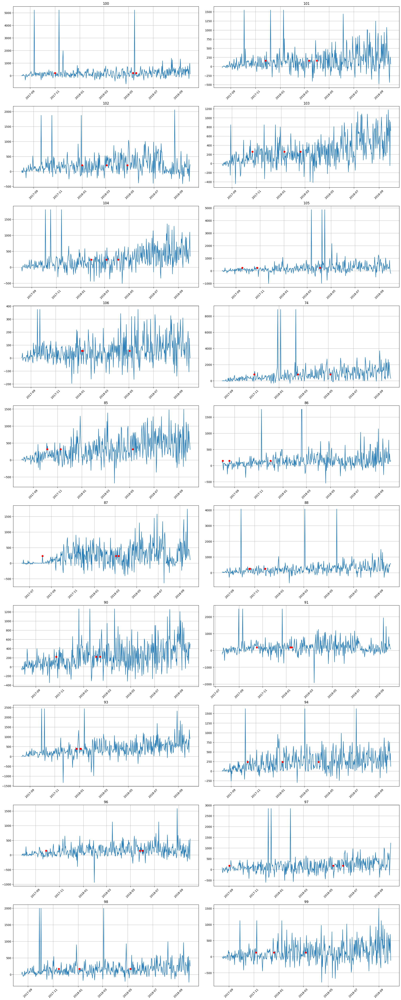

In [25]:
ts_new = ts
from etna.analysis import plot_imputation
from etna.transforms import TimeSeriesImputerTransform

imputer = TimeSeriesImputerTransform(in_column="target", strategy="mean") #По среднему
plot_imputation(ts_new, imputer)

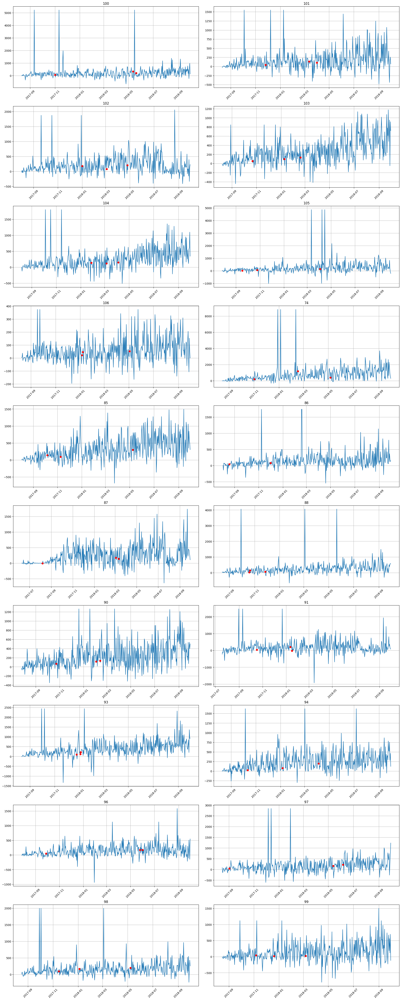

In [28]:
imputer = TimeSeriesImputerTransform(in_column="target", strategy="seasonal", seasonality = 7) #По сезонности (7 периодов-дней)
plot_imputation(ts_new, imputer)

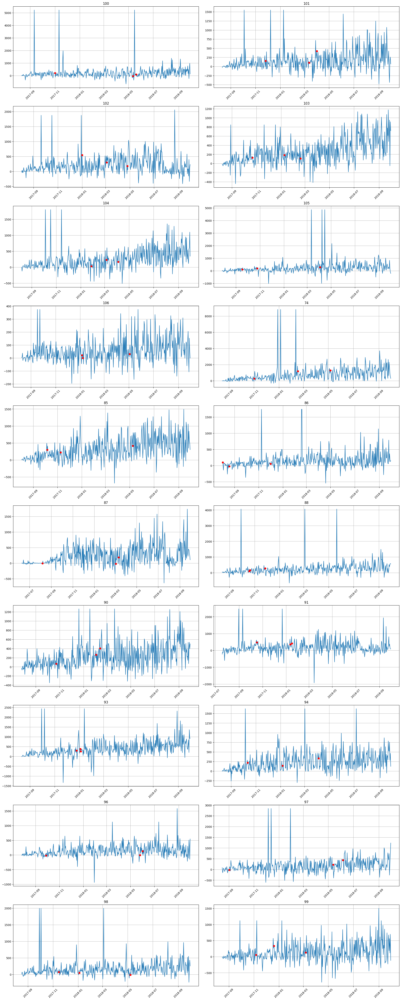

In [26]:
imputer = TimeSeriesImputerTransform(in_column="target", strategy="running_mean", window=3) #Скользящее среднее
plot_imputation(ts_new, imputer)

В данных есть пропущенные значения.
Сначала я посмотрела метод заполнения пропусков по среднему, мне он не понравился, тк у нас есть тренд (мы уже выше это выяснили) и в таком случае наши заполненные пропуски могут стать выбросами в самом начале промежутка (то есть они сильно выше значений, которые были в начальный период времени, тк далее таргет увеличивался -> общее средне намного выше). Далее я посмотрела способ заполнения пропусков по сезонности (взяла 7 дней), он показался хорошим, пропуски не заполнялись какими-то аномальными значениями. Еще рассмотрела способ скользящего среднего, он учитывал 3 периода и не приводил к аномальным значениям. Его решила оставить, так как он лучше всего вписался в данные (учитывал именно тот временной отрезок, в котором находится)


In [58]:
ts_new.fit_transform([imputer]) #Заполнила скользящим средним

Проверьте ряды на наличие выбросов, и очистите их соответствующим образом. Обоснуйте выбор.

In [10]:
#Тут импортирую все для последующих заданий
import warnings
import gdown
import os
import zipfile
import matplotlib.pyplot as plt
import pandas as pd
from etna.analysis import cross_corr_plot
from etna.analysis import distribution_plot
from etna.analysis import plot_anomalies
from etna.analysis import plot_anomalies_interactive
from etna.analysis import plot_backtest
from etna.analysis import plot_correlation_matrix
from etna.analysis import plot_forecast
from etna.analysis import acf_plot
from etna.analysis.outliers import get_anomalies_density
from etna.analysis.outliers import get_anomalies_hist
from etna.analysis.outliers import get_anomalies_median
from etna.analysis.outliers import get_anomalies_prediction_interval
from etna.datasets import TSDataset
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.metrics import MAE, MAPE, MSE, SMAPE
from etna.models import CatBoostPerSegmentModel
from etna.models import CatBoostMultiSegmentModel
from etna.models import LinearPerSegmentModel
from etna.models import MovingAverageModel
from etna.models import NaiveModel
from etna.models import AutoARIMAModel
from etna.models import ProphetModel
from etna.models import SeasonalMovingAverageModel
from etna.pipeline import AutoRegressivePipeline, Pipeline, assemble_pipelines
from etna.transforms import DateFlagsTransform
from etna.transforms import FilterFeaturesTransform
from etna.transforms import HolidayTransform
from etna.transforms import LagTransform
from etna.transforms import LinearTrendTransform
from etna.transforms import LogTransform
from etna.transforms import MeanTransform
from etna.transforms import MedianOutliersTransform
from etna.transforms import SegmentEncoderTransform
from etna.transforms import TimeSeriesImputerTransform
from etna.transforms import DensityOutliersTransform
from etna.datasets import load_dataset

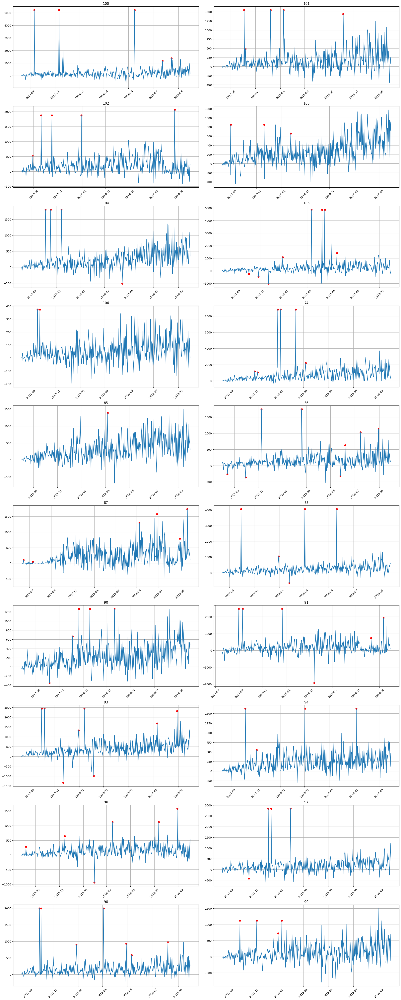

In [32]:
#YOUR CODE HERE#
anomaly_dict = get_anomalies_median(ts, window_size=30)  # задаем размер окна
plot_anomalies(ts, anomaly_dict)

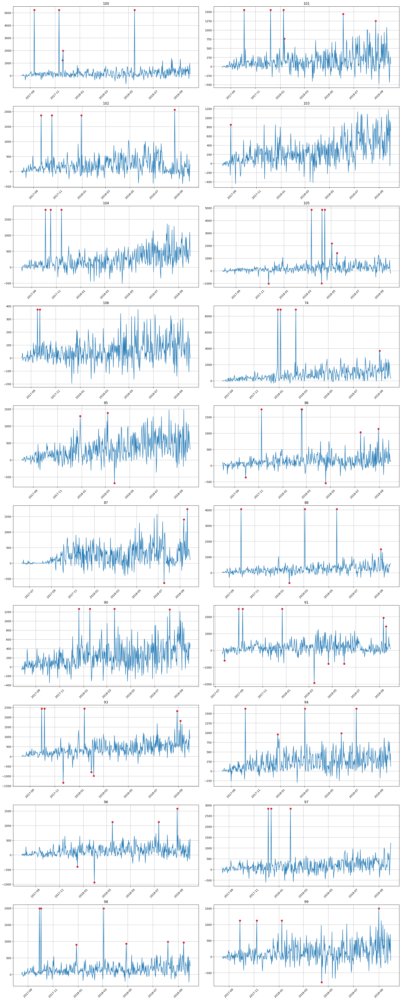

In [33]:
anomaly_dict = get_anomalies_density(ts, window_size=100, distance_coef=1, n_neighbors=4) #Метод на основе плотности точек
plot_anomalies(ts, anomaly_dict)

In [40]:
segment = "94"
method = get_anomalies_density
params_bounds = {"window_size": (3, 70, 1), "distance_coef": (0.1, 1, 0.1), 'n_neighbors':(1,30,3)}
# window_size=100, distance_coef=1, n_neighbors=4

In [41]:
plot_anomalies_interactive(ts=ts, segment=segment, method=method, params_bounds=params_bounds)

interactive(children=(IntSlider(value=3, continuous_update=False, description='window_size', max=70, min=3, st…

Для выбросов проверила способы из семинара. Сначала способ отклонения от медианных значений, рассчитанных по окну. Перебрала параметры, хорошим показалось окно 30, но была проблема, что ловились выбросы, не сильно отличающиеся от всей выборки (те по факту их можно выбросами и не считать, тк они повторялись с определенной периодичностью на данном промежутке). Далее проверила метод на основе плотности точек. Он показался хорошим, и я решила с помощью интерактивной визуализации подобрать параметры этого метода (на сегменте 94) -> подобрала параметры  window_size=100, distance_coef=1, n_neighbors=4, которые ловили только самые аномальные значения (и их было не сильно много).

In [28]:
in_params = {"window_size":100, "distance_coef":1, "n_neighbors":4}
outliers_remover_in = DensityOutliersTransform(in_column="target", **in_params)
ts_new.fit_transform([outliers_remover_in])

### Задание 3. Построение Prophet (1.25 балла)

Постройте прогнозы с помощью Prophet и `etna.Pipeline`, под капотом `etna.Pipeline` обучит `ProphetModel` для каждого сегмента в отдельности. После этого оцените качество по SMAPE на кросс-валидации. В качестве горизонта предсказания возьмите 5 дней - этого же горизонта будем придерживаться и в дальнейшем.

Отрисуйте получившийся прогноз.

In [11]:
from etna.pipeline import Pipeline
from etna.models import ProphetModel
from etna.metrics import SMAPE, MAE
from etna.analysis import plot_backtest

In [44]:
HORIZON = 5

In [61]:
#YOUR CODE HERE#
train_ts, test_ts = ts_new.train_test_split(test_size=HORIZON) #Разбиваем на трейн-тест

model = ProphetModel()
pipeline = Pipeline(model=model, horizon=HORIZON)
pipeline.fit(train_ts)

forecast_ts = pipeline.forecast(train_ts)
smape = SMAPE()
print(f"{smape(y_true=test_ts, y_pred=forecast_ts)}")

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjd2sucz1/bwgajkvn.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjd2sucz1/94leyk9n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93962', 'data', 'file=/tmp/tmpjd2sucz1/bwgajkvn.json', 'init=/tmp/tmpjd2sucz1/94leyk9n.json', 'output', 'file=/tmp/tmpjd2sucz1/prophet_modelb15yg_be/prophet_model-20240525121503.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
12:15:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
12:15:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonalit

{'100': 101.70771646690358, '101': 114.78956655672108, '102': 112.20215014347137, '103': 77.48350072167925, '104': 45.71403138452293, '105': 131.4080228591568, '106': 133.63635200328468, '74': 55.88330518358807, '85': 30.280241767621796, '86': 28.22049761578935, '87': 49.0832208708496, '88': 25.71004895541689, '90': 41.38365123820825, '91': 59.03408856569384, '93': 53.99459407363874, '94': 51.031314850036495, '96': 125.60519907097701, '97': 86.06510772239095, '98': 93.44762376097536, '99': 88.15283863400992}


In [66]:
pd.DataFrame(smape(y_true=test_ts, y_pred=forecast_ts), index = ['SMAPE']).T #Качество предсказания

,SMAPE
100,101.707716
101,114.789567
102,112.202150
103,77.483501
104,45.714031
105,131.408023
106,133.636352
74,55.883305
85,30.280242
86,28.220498


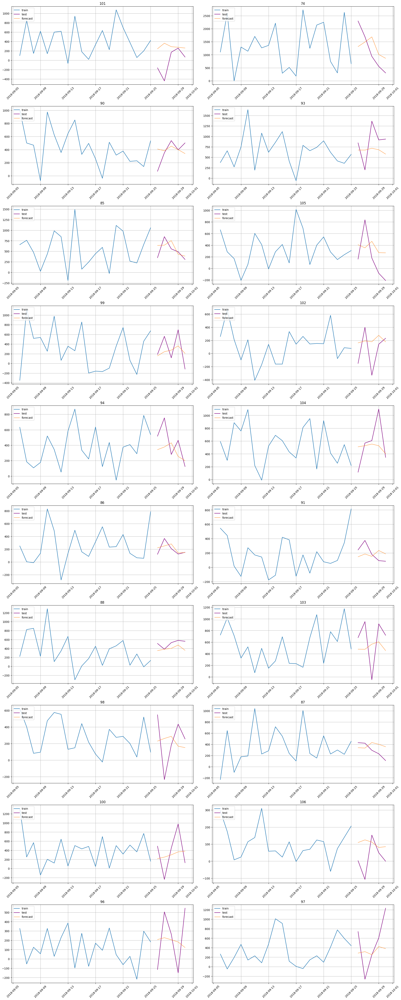

In [67]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=20)

Исходя из статистики по каждому ряду, какой можно сделать вывод о том, как лучше предсказывать итоговое значение? Посчитайте то же самое исходя из MAE.

Я бы сказала, что лучше предсказывать итоговое значение каком-то другим способом. Потому что у нас есть предсказания, кторое очень плохи (банкоматы 101, 93, 96 и другие). При этом все же есть хорошие прогнозы (банкомат 88), но их очень мало.

In [70]:
#YOUR CODE HERE#
mae = MAE()
pd.DataFrame(mae(y_true=test_ts, y_pred=forecast_ts), index = ['MAE']).T #Качество предсказания

,MAE
100,355.301096
101,307.529168
102,244.070296
103,373.356617
104,223.394518
105,369.553075
106,99.170397
74,591.081085
85,165.206548
86,62.075711


In [71]:
smape_data_4task = pd.DataFrame(smape(y_true=test_ts, y_pred=forecast_ts), index = ['SMAPE']).T
mae_data_4task = pd.DataFrame(mae(y_true=test_ts, y_pred=forecast_ts), index = ['MAE']).T
pd.concat([smape_data_4task, mae_data_4task], axis = 1)

,SMAPE,MAE
100,101.707716,355.301096
101,114.789567,307.529168
102,112.202150,244.070296
103,77.483501,373.356617
104,45.714031,223.394518
105,131.408023,369.553075
106,133.636352,99.170397
74,55.883305,591.081085
85,30.280242,165.206548
86,28.220498,62.075711


После сравнения ошибок можно увидеть, что они очень сильно отличаются. Например ряд 74 по SMAPE имеет небольшую ошибку, а по MAE самую максимальную. Объяснить можно тем, что MAE чувствителен к аномалиям и масштаблу, а у нас как раз часто встречается такая ситуация (есть пики в некоторых данных, колебания + масштабы разные)

### Задание 4. Иерархический временной ряд (2 балла)

Вопрос, поставленный в прошлом задании, тем не менее, естественным образом подводит нас к концепции **иерархического временного ряда** (когда один ряд состоит из других в качестве компонент). Это полезная концепция, которая может встретиться во многих задачах. В этом задании вам предстоит самостоятельно разобраться в деталях ее реализации в ETNA с использованием справочных материалов, предоставляемых библиотекой (как это часто бывает на практике). Они содержатся по следующей ссылке:

https://github.com/etna-team/etna/blob/master/examples/303-hierarchical_pipeline.ipynb

На выходе из первой части задания необходимо получить `TSDataset` с иерархической структурой, а также соответствующий реконсилятор, который позволит собирать искомый ряд из составных компонент. Классы, которые вам понадобятся, импортированы ниже.

In [12]:
from etna.datasets import HierarchicalStructure
from etna.pipeline import HierarchicalPipeline
from etna.reconciliation import TopDownReconciliator

In [48]:
data_help = ts.to_pandas()
# data_help = data_help.dropna()
data_help = data_help.reset_index()
periods = data_help.timestamp.unique() #Тут периоды
segments_list = [str(x) for x in list(df.segment.unique())] #Тут все сегменты в виде строк

In [49]:
#Идея такая: банкоматы с индексом до 100 объединим в одну группу, 100 и выше - в другую, а потом из них складывается итог
#И представим, что у нас на каждый банкомат влияет и общий итог, и значение его группы банкоматов до 100
hierarchical_df = pd.DataFrame()
hierarchical_df['timestamp'] = periods
hierarchical_df['bank'] = segments_list[0]
hierarchical_df['target'] = list(data_help[(f'{segments_list[0]}','target')])
for x in range(len(segments_list)-1): #-1, тк 1 сегмент мы на предыдущем шаге сделали
  df_helper = pd.DataFrame()
  y = x+1
  df_helper['timestamp'] = periods
  df_helper['bank'] = segments_list[y]
  df_helper['target'] = list(data_help[(f'{segments_list[y]}','target')])
  hierarchical_df = pd.concat([hierarchical_df, df_helper], axis = 0)
hierarchical_df['STO'] = hierarchical_df['bank'].apply(lambda x: 'Do_100' if int(x)<100 else 'Posle_100')
hierarchical_df['Itog'] = 'Itog'
hierarchical_df = hierarchical_df[['timestamp', 'Itog', 'STO', 'bank', 'target']]
hierarchical_df.head(-1)
#Поскольку у нас TopDownReconciliator не работает с отрицтаельными значениями, мы добавим константу ко всем значениям
#Это можно делать, тк константа является линейным преобразованием модели
mini = hierarchical_df['target'].min()
hierarchical_df['target'] = hierarchical_df['target'].apply(lambda x: x+abs(mini)+1)
hierarchical_df

,timestamp,Itog,STO,bank,target
0,2017-06-09,Itog,Do_100,74,NaN
1,2017-06-10,Itog,Do_100,74,NaN
2,2017-06-11,Itog,Do_100,74,NaN
3,2017-06-12,Itog,Do_100,74,NaN
4,2017-06-13,Itog,Do_100,74,NaN
...,...,...,...,...,...
474,2018-09-26,Itog,Posle_100,106,1929.090402
475,2018-09-27,Itog,Posle_100,106,1819.508052
476,2018-09-28,Itog,Posle_100,106,2079.387374
477,2018-09-29,Itog,Posle_100,106,1976.071076


In [50]:
hierarchical_df, hierarchical_structure = TSDataset.to_hierarchical_dataset(
    df=hierarchical_df, level_columns=["bank", 'STO', 'Itog']
)
hierarchical_ts = TSDataset(df=hierarchical_df, freq="D", hierarchical_structure=hierarchical_structure)
hierarchical_ts.head(-1)

segment,100_Posle_100_Itog,101_Posle_100_Itog,102_Posle_100_Itog,103_Posle_100_Itog,104_Posle_100_Itog,105_Posle_100_Itog,106_Posle_100_Itog,74_Do_100_Itog,85_Do_100_Itog,86_Do_100_Itog,87_Do_100_Itog,88_Do_100_Itog,90_Do_100_Itog,91_Do_100_Itog,93_Do_100_Itog,94_Do_100_Itog,96_Do_100_Itog,97_Do_100_Itog,98_Do_100_Itog,99_Do_100_Itog
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1926.913464,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1927.737170,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1926.060339,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1912.763367,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1933.694331,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-09-25,2084.241357,2349.357097,2003.518145,2407.428387,2143.930642,2233.449860,2132.281082,2580.347863,2984.346360,2714.111875,2380.131351,2056.558944,2459.645480,2740.382220,2496.418080,2463.587503,2109.305562,2368.743612,2022.051535,2600.852265
2018-09-26,2415.724286,1764.849259,1774.645480,2604.000000,2041.114451,2086.800730,1929.090402,4223.524157,2274.370410,2046.674469,2356.458621,2437.640756,1995.634099,2169.318445,2771.212368,2443.318445,1812.212368,2665.866223,2473.471978,2113.512347


In [51]:
hierarchical_ts.hierarchical_structure

HierarchicalStructure(level_structure = {'total': ['74', '85', '86', '87', '88', '90', '91', '93', '94', '96', '97', '98', '99', '100', '101', '102', '103', '104', '105', '106'], '100': ['100_Posle_100'], '101': ['101_Posle_100'], '102': ['102_Posle_100'], '103': ['103_Posle_100'], '104': ['104_Posle_100'], '105': ['105_Posle_100'], '106': ['106_Posle_100'], '74': ['74_Do_100'], '85': ['85_Do_100'], '86': ['86_Do_100'], '87': ['87_Do_100'], '88': ['88_Do_100'], '90': ['90_Do_100'], '91': ['91_Do_100'], '93': ['93_Do_100'], '94': ['94_Do_100'], '96': ['96_Do_100'], '97': ['97_Do_100'], '98': ['98_Do_100'], '99': ['99_Do_100'], '100_Posle_100': ['100_Posle_100_Itog'], '101_Posle_100': ['101_Posle_100_Itog'], '102_Posle_100': ['102_Posle_100_Itog'], '103_Posle_100': ['103_Posle_100_Itog'], '104_Posle_100': ['104_Posle_100_Itog'], '105_Posle_100': ['105_Posle_100_Itog'], '106_Posle_100': ['106_Posle_100_Itog'], '74_Do_100': ['74_Do_100_Itog'], '85_Do_100': ['85_Do_100_Itog'], '86_Do_100': 

In [96]:
hierarchical_ts.hierarchical_structure.level_names

['total', 'Itog', 'STO', 'bank']

In [52]:
ahp_reconciliator = TopDownReconciliator(
    target_level="Itog", source_level="bank", method="AHP", period = 7)
ahp_reconciliator.fit(ts=hierarchical_ts)
ahp_reconciliator.mapping_matrix.toarray()
ahp_reconciliator.aggregate(ts=hierarchical_ts).head(-1)

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1926.913464,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1927.737170,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1926.060339,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1912.763367,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1933.694331,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-09-25,2084.241357,2349.357097,2003.518145,2407.428387,2143.930642,2233.449860,2132.281082,2580.347863,2984.346360,2714.111875,2380.131351,2056.558944,2459.645480,2740.382220,2496.418080,2463.587503,2109.305562,2368.743612,2022.051535,2600.852265
2018-09-26,2415.724286,1764.849259,1774.645480,2604.000000,2041.114451,2086.800730,1929.090402,4223.524157,2274.370410,2046.674469,2356.458621,2437.640756,1995.634099,2169.318445,2771.212368,2443.318445,1812.212368,2665.866223,2473.471978,2113.512347


Во второй части задания примените найденные на предыдущих этапах преобразования очистку от выбросов уже к иерархическому датасету, и запустите на нем Prophet с MAE на кросс-валидации.

In [110]:
#YOUR CODE HERE#
hierarchical_ts.fit_transform([outliers_remover_in]) #Применяем очистку от выбросов
hierarchical_ts.fit_transform([imputer])
HORIZON = 5
train_ts, test_ts = hierarchical_ts.train_test_split(test_size=HORIZON)
model = ProphetModel()
pipeline = HierarchicalPipeline(
    model=model,
    reconciliator=ahp_reconciliator,
    horizon = HORIZON
)
pipeline.fit(train_ts)

forecast_ts = pipeline.forecast(train_ts)
mae = MAE()
# print(f"{mae(y_true=test_ts, y_pred=forecast_ts)}")

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjd2sucz1/8wx6j8t5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjd2sucz1/4sc4jnql.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6873', 'data', 'file=/tmp/tmpjd2sucz1/8wx6j8t5.json', 'init=/tmp/tmpjd2sucz1/4sc4jnql.json', 'output', 'file=/tmp/tmpjd2sucz1/prophet_modelv26pruf6/prophet_model-20240525132852.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:28:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:28:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonality

In [111]:
pd.DataFrame(mae(y_true=test_ts, y_pred=forecast_ts), index = ['MAE']).T

,MAE
100_Posle_100_Itog,270.144889
101_Posle_100_Itog,330.705031
102_Posle_100_Itog,229.003930
103_Posle_100_Itog,346.968448
104_Posle_100_Itog,219.995383
105_Posle_100_Itog,377.248311
106_Posle_100_Itog,101.729183
74_Do_100_Itog,592.533015
85_Do_100_Itog,165.244977
86_Do_100_Itog,58.548675


Я бы не сказала, что ситуация стала лучше. В принципе объяснить это можно тем, что у нас банкоматы разные и по идее не должны зависеть друг от друга (и мы видели это при анализе данных, они очень по-разному себя ведут) -> здесь вряд ли можно говорить о какой-то иерархии

### Задание 5. Построение признаков (1.5 балла)

Вернемся к нашему исходному мультисегментному ряду - теперь поработаем с моделями, которые требуют построения признаков - `ARIMA` и `CatBoost`. Построим для них признаки, и попробуем при помощи них добиться улучшения качества.

Из обязательного:
1) постройте графики автокорреляции и при помощи них обоснуйте выбор лаговых признаков
2) для катбуста включите в признаки результаты STL разложения. STL используем для убирания тренда за счет преобразования на месте.
* Кроме этого, подумайте на экспертном уровне,
    - Какие еще закономерности могут присутствовать и почему?
    - Что из этого кажется более предсказуемым, и почему?
    - Cделайте соответствующие признаки, и снабдите их кратким комментарием.

3) После этого, обучите на получившихся признаках модели. Для `CatBoost` рассмотрите 2 версии мультисегментную и на каждый ряд в отдельности.

Ниже приведены импорты, которые вам точно понадобятся - к ним необходимо добавить те инструменты, которые вы дополнительно решите использовать в анализе.

In [13]:
from etna.analysis import acf_plot, stl_plot
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.models import (CatBoostMultiSegmentModel, CatBoostPerSegmentModel,
                         AutoARIMAModel)
from etna.transforms import STLTransform, LagTransform, SegmentEncoderTransform

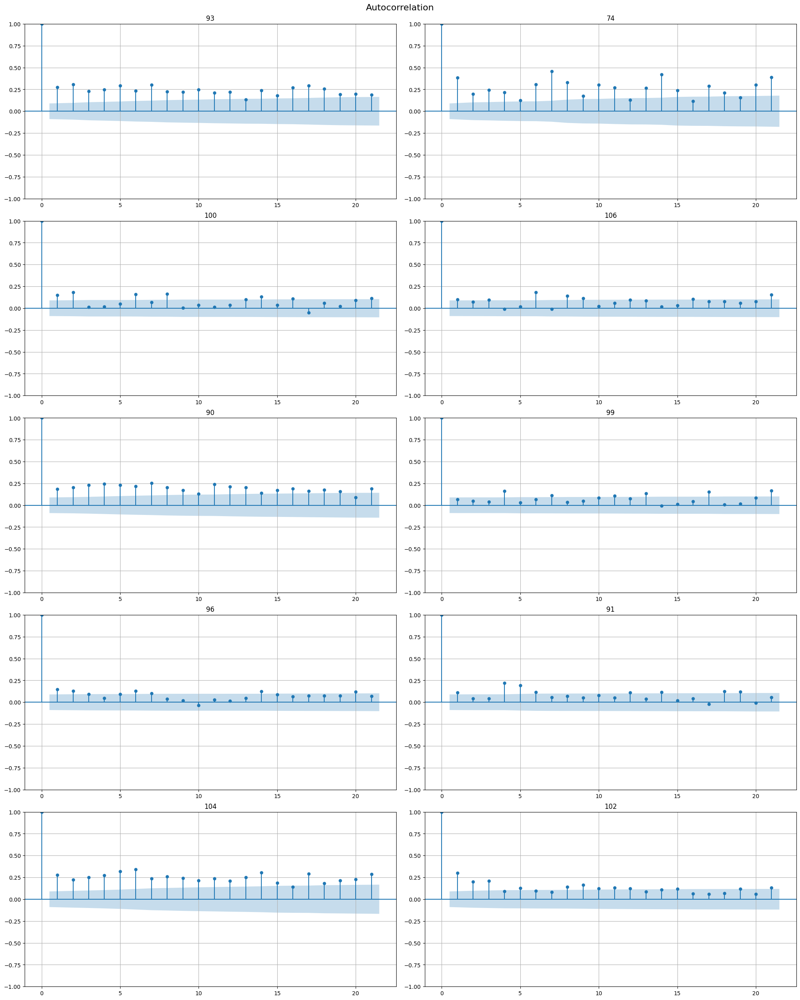

In [114]:
acf_plot(ts, lags=21)
#Вообще у нас часто значим 7 лаг, 14 тоже иногда
#Но есть случаи, где вообще все лаги значимые (сегмент 93, 104 например)
# Давайте попробуем в таком случае взять с 1 по 7 лаг

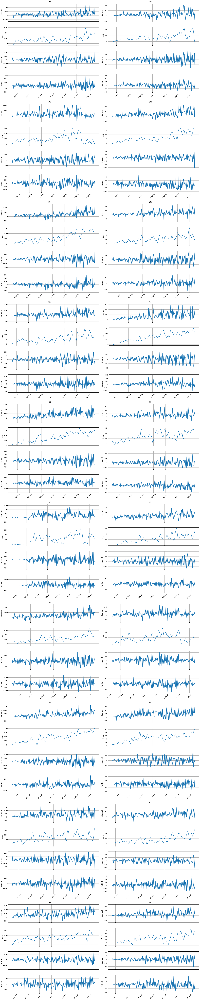

In [115]:
stl_plot(ts, period=7)

In [17]:
from etna.transforms import FourierTransform
from etna.transforms import TrendTransform
lags = LagTransform(in_column="target", lags=[7,14])
stl = STLTransform(in_column="target", period=7)
seg = SegmentEncoderTransform()
fourier = FourierTransform(period=7, order=3) #Можно сказать про сезонность, мы видели некоторые паттерны ранее на графиках, возьмем 7 в качестве периода

In [156]:
#CatBoostMultiSegmentModel
HORIZON = 5
train_ts, test_ts = ts_new.train_test_split(test_size=HORIZON)
transforms = [lags, stl, seg, fourier]
model = CatBoostMultiSegmentModel()
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)
pipeline.fit(train_ts)
forecast_ts = pipeline.forecast(train_ts)

In [157]:
smape_data_5task = pd.DataFrame(smape(y_true=test_ts, y_pred=forecast_ts), index = ['SMAPE']).T
mae_data_5task = pd.DataFrame(mae(y_true=test_ts, y_pred=forecast_ts), index = ['MAE']).T
pd.concat([smape_data_5task, mae_data_5task], axis = 1)

,SMAPE,MAE
100,82.298441,301.620052
101,155.075738,365.568755
102,126.009595,265.732448
103,49.808392,234.317837
104,68.624053,296.676821
105,139.628609,282.013287
106,153.118518,132.897629
74,55.881922,649.904296
85,41.590161,273.236780
86,37.497369,64.356320


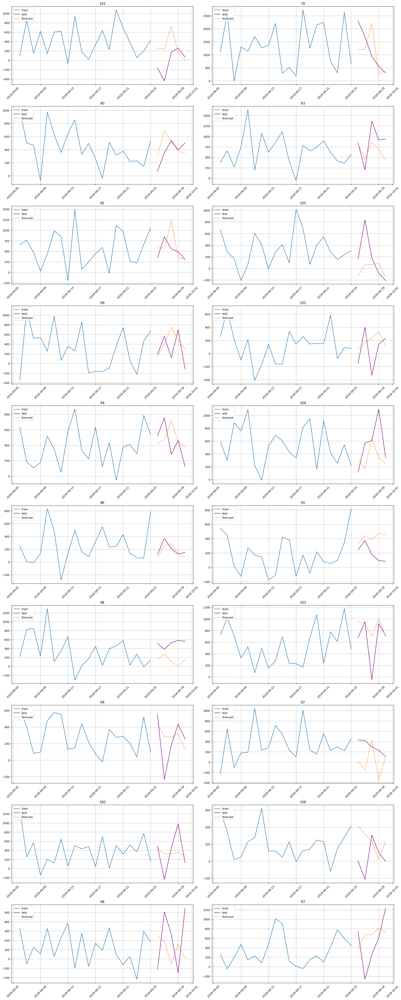

In [158]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=20)

In [175]:
#CatBoostPerSegmentModel
HORIZON = 5
train_ts, test_ts = ts_new.train_test_split(test_size=HORIZON)
transforms = [lags, stl, seg, fourier]
train_ts.inverse_transform(transforms)
model = CatBoostPerSegmentModel()
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)
pipeline.fit(train_ts)
forecast_ts = pipeline.forecast(train_ts)

In [176]:
smape_data_5task = pd.DataFrame(smape(y_true=test_ts, y_pred=forecast_ts), index = ['SMAPE']).T
mae_data_5task = pd.DataFrame(mae(y_true=test_ts, y_pred=forecast_ts), index = ['MAE']).T
pd.concat([smape_data_5task, mae_data_5task], axis = 1)

,SMAPE,MAE
100,95.081313,343.811787
101,145.600531,359.048320
102,108.509558,227.347807
103,52.103240,256.398276
104,88.053699,361.859975
105,99.469365,249.755826
106,122.552658,124.488704
74,50.913491,623.054428
85,49.249253,326.805574
86,71.116000,96.641956


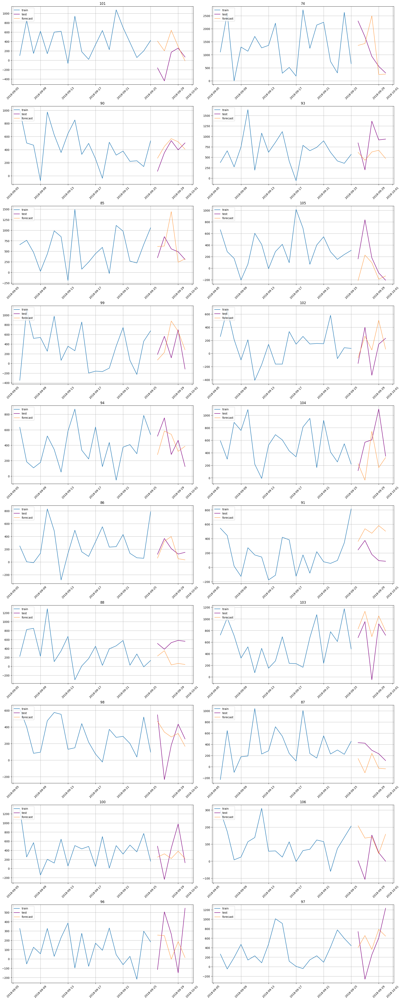

In [177]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=20)

In [170]:
#AutoARIMAModel
train_ts, test_ts = ts_new.train_test_split(test_size=HORIZON)
train_ts.inverse_transform(transforms)
transforms = [lags, seg, fourier]
model = AutoARIMAModel()
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)
pipeline.fit(train_ts)
forecast_ts = pipeline.forecast(train_ts)

In [171]:
smape_data_5task = pd.DataFrame(smape(y_true=test_ts, y_pred=forecast_ts), index = ['SMAPE']).T
mae_data_5task = pd.DataFrame(mae(y_true=test_ts, y_pred=forecast_ts), index = ['MAE']).T
pd.concat([smape_data_5task, mae_data_5task], axis = 1)

,SMAPE,MAE
100,95.571869,334.120012
101,104.249251,269.557303
102,110.205805,230.593879
103,89.392747,373.820944
104,60.392462,274.762995
105,125.656218,282.284783
106,137.772724,76.301052
74,37.230368,501.732298
85,58.529959,254.267761
86,48.638871,83.241079


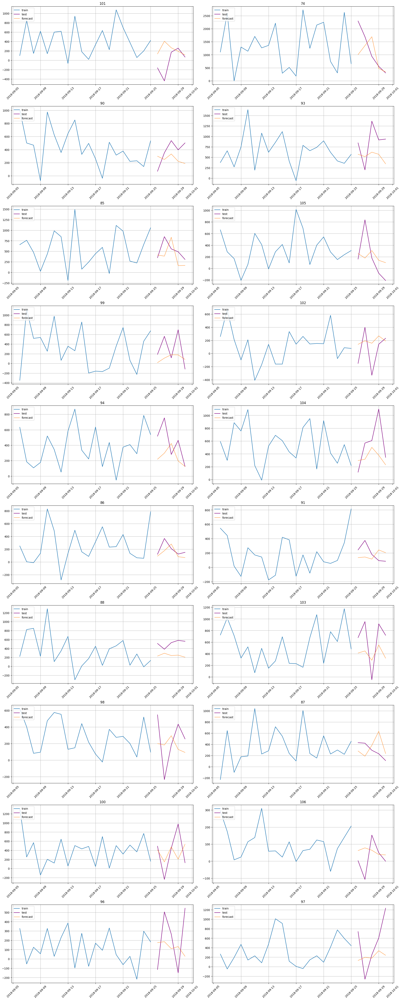

In [172]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=20)

В принципе здесь модели работают получше, иногда естьочень хорошие прогнозы (86 банкомат)

### Задание 6. Стратегии прогнозирования (1.25 балла)

Как нам известно по семинарским занятиям, при построении прогноза на горизонте дальше следующего наблюдения перед нами встает задача определиться со стратегией генерации прогноза. Попробуйте разные стратегии на нашем горизонте из 5 дней (прямая, рекурсивная). Какая стратегия в совокупности с какой моделью дает лучший результат?

Учитывайте особенности, которые некоторые стратегии могут накладывать на признаки (в частности, на лаговые переменные).

При необходимости, в смешанном методе пользуйтесь упрощенной схемой спецификации моделей/преобразований.

In [14]:
from etna.pipeline import AutoRegressivePipeline, Pipeline, assemble_pipelines
from etna.ensembles import DirectEnsemble

In [179]:
HORIZON = 5
model = CatBoostPerSegmentModel()
NUMBER_OF_LAGS = 7
transforms = [
    LinearTrendTransform(in_column="target"),
    LagTransform(
        in_column="target",
        lags=[i for i in range(1, 1 + NUMBER_OF_LAGS)],
        out_column="target_lag",
    ),
]

autoregressivepipeline = AutoRegressivePipeline(model=model, transforms=transforms, horizon=HORIZON, step=1)

metrics_recursive_df, forecast_recursive_df, _ = autoregressivepipeline.backtest(
    ts=ts, metrics=[SMAPE(), MAE()]
)

autoregressive_pipeline_metrics = metrics_recursive_df.mean()

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   56.5s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  2.0min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  2.9min
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:  3.7min
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:  4.5min
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:  4.5min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    3.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    6.6s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    9.2s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   11.9s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   14.5s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   14.5s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Do

In [180]:
model = CatBoostPerSegmentModel()
transforms = [
    LinearTrendTransform(in_column="target"),
    LagTransform(
        in_column="target",
        lags=list(range(HORIZON, HORIZON + NUMBER_OF_LAGS)),
        out_column="target_lag",
    ),
]

pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_pipeline_df, forecast_pipeline_df, _ = pipeline.backtest(ts=ts, metrics=[SMAPE(), MAE()])

pipeline_metrics = metrics_pipeline_df.mean()

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   57.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  2.7min
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:  3.6min
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:  4.4min
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:  4.4min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.9s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    1.4s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    1.9s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:    2.3s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:    2.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Do

In [182]:
horizons = [5, 10]

model_1 = CatBoostPerSegmentModel()
transforms_1 = [
    LinearTrendTransform(in_column="target"),
    LagTransform(
        in_column="target",
        lags=[i for i in range(horizons[0], horizons[0] + NUMBER_OF_LAGS)],
        out_column="target_lag",
    ),
]
pipeline_1 = Pipeline(model=model_1, transforms=transforms_1, horizon=horizons[0])


model_2 = CatBoostPerSegmentModel()
transforms_2 = [
    LinearTrendTransform(in_column="target"),
    LagTransform(
        in_column="target",
        lags=[i for i in range(horizons[1], horizons[1] + NUMBER_OF_LAGS)],
        out_column="target_lag",
    ),
]

pipeline_2 = Pipeline(model=model_2, transforms=transforms_2, horizon=horizons[1])
ensemble = DirectEnsemble(pipelines=[pipeline_1, pipeline_2])

metrics_ensemble_df, forecast_ensemble_df, _ = ensemble.backtest(ts=ts, metrics=[SMAPE(), MAE()])

ensemble_metrics = metrics_ensemble_df.mean()

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   53.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   52.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.7min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.7min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  3.5min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   51.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.7min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.7min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  5.2min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   49.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:  7.0min
[Parallel(n_jobs=1)]: Do

In [184]:
df_res = pd.DataFrame(
    data=[ensemble_metrics, pipeline_metrics, autoregressive_pipeline_metrics],
    index=["direct_ensemble", "pipeline", "autoregressive_pipeline"],
).drop("fold_number", axis=1)

df_res = df_res.sort_values(by="SMAPE")
df_res

,segment,SMAPE,MAE
autoregressive_pipeline,1.001001e+232,80.349574,267.015450
pipeline,1.001001e+232,82.862568,279.827363
direct_ensemble,1.001001e+232,84.835566,261.469677


Видим, что с CatBoostPerSegmentModel лучше всего работает direct_ensemble если ориентироваться на МАЕ, и autoregressive_pipeline, если смотреть на SMAPE


In [186]:
HORIZON = 5
model = CatBoostMultiSegmentModel()
NUMBER_OF_LAGS = 7
transforms = [
    LinearTrendTransform(in_column="target"),
    LagTransform(
        in_column="target",
        lags=[i for i in range(1, 1 + NUMBER_OF_LAGS)],
        out_column="target_lag",
    ),
]

autoregressivepipeline = AutoRegressivePipeline(model=model, transforms=transforms, horizon=HORIZON, step=1)

metrics_recursive_df, forecast_recursive_df, _ = autoregressivepipeline.backtest(
    ts=ts, metrics=[SMAPE(), MAE()]
)

autoregressive_pipeline_metrics = metrics_recursive_df.mean()

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    4.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    9.9s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   13.7s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   17.7s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   24.2s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   24.2s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    3.2s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    5.5s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    7.7s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   10.4s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   14.5s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   14.5s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Do

In [187]:
model = CatBoostMultiSegmentModel()
transforms = [
    LinearTrendTransform(in_column="target"),
    LagTransform(
        in_column="target",
        lags=list(range(HORIZON, HORIZON + NUMBER_OF_LAGS)),
        out_column="target_lag",
    ),
]

pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_pipeline_df, forecast_pipeline_df, _ = pipeline.backtest(ts=ts, metrics=[SMAPE(), MAE()])

pipeline_metrics = metrics_pipeline_df.mean()

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    5.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   14.6s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   18.5s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   24.3s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   28.3s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   28.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    1.0s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    1.3s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:    1.7s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:    1.7s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Do

In [188]:
horizons = [5, 10]

model_1 = CatBoostMultiSegmentModel()
transforms_1 = [
    LinearTrendTransform(in_column="target"),
    LagTransform(
        in_column="target",
        lags=[i for i in range(horizons[0], horizons[0] + NUMBER_OF_LAGS)],
        out_column="target_lag",
    ),
]
pipeline_1 = Pipeline(model=model_1, transforms=transforms_1, horizon=horizons[0])


model_2 = CatBoostMultiSegmentModel()
transforms_2 = [
    LinearTrendTransform(in_column="target"),
    LagTransform(
        in_column="target",
        lags=[i for i in range(horizons[1], horizons[1] + NUMBER_OF_LAGS)],
        out_column="target_lag",
    ),
]

pipeline_2 = Pipeline(model=model_2, transforms=transforms_2, horizon=horizons[1])
ensemble = DirectEnsemble(pipelines=[pipeline_1, pipeline_2])

metrics_ensemble_df, forecast_ensemble_df, _ = ensemble.backtest(ts=ts, metrics=[SMAPE(), MAE()])

ensemble_metrics = metrics_ensemble_df.mean()

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    6.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   10.3s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   10.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   10.4s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    4.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   10.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   10.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   20.4s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    3.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    7.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    7.9s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   28.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    5.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    9.6s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    9.6s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   37.9s
[Parallel(n_jobs=1)]: Do

In [189]:
df_res = pd.DataFrame(
    data=[ensemble_metrics, pipeline_metrics, autoregressive_pipeline_metrics],
    index=["direct_ensemble", "pipeline", "autoregressive_pipeline"],
).drop("fold_number", axis=1)

df_res = df_res.sort_values(by="SMAPE")
df_res

,segment,SMAPE,MAE
autoregressive_pipeline,1.001001e+232,78.294456,272.543609
pipeline,1.001001e+232,81.166299,279.688506
direct_ensemble,1.001001e+232,84.472269,266.311403


Для CatBoostMultiSegmentModel по SMAPE лучше всего autoregressive_pipeline, по MAE лучше всего direct_ensemble



### Задание 7. Ансамбли (1.25 балла)

Чтобы не выбирать лучшую модель, мы можем использовать преимущества каждой - давайте объединим все наши наработки в ансамбль. Попробуйте различные опции ансамблирования, и выберите ту, которая работает лучше всего (не забывайте, что внутри каждого ансамбля у нас тоже есть параметры, которые мы можем варьировать - веса в voting, включаемые признаки в stacking).

In [15]:
from etna.ensembles import StackingEnsemble, VotingEnsemble

In [18]:
#YOUR CODE HERE#
HORIZON = 5
transforms = [lags, seg, fourier]
model_1 = AutoARIMAModel()
pipeline_1 = Pipeline(model=model_1, transforms=transforms, horizon=HORIZON)


transforms = [lags, stl, seg, fourier]
model_2 = CatBoostPerSegmentModel()
pipeline_2 = Pipeline(model=model_2, transforms=transforms, horizon=HORIZON)

model_3 = ProphetModel()
pipeline_3 = Pipeline(model=model_3, horizon=HORIZON)

transforms = [lags, stl, seg, fourier]
model_4 = CatBoostMultiSegmentModel()
pipeline_4 = Pipeline(model=model_4, transforms=transforms, horizon=HORIZON)


pipeline_names = ["AutoARIMAModel", "CatBoostPerSegmentModel", 'ProphetModel','CatBoostMultiSegmentModel']
pipelines = [pipeline_1, pipeline_2,  pipeline_3, pipeline_4]

In [204]:
HORIZON = 5
N_FOLDS = 5
voting_ensemble = VotingEnsemble(pipelines=pipelines, weights=[2, 4, 2, 5], n_jobs=4)
voting_ensamble_metrics = voting_ensemble.backtest(
    ts=ts,
    metrics=[MAE(), SMAPE()],
    n_folds=N_FOLDS,
    aggregate_metrics=True,
    n_jobs=2,
)[0].iloc[:, 1:]

voting_ensamble_metrics

[Parallel(n_jobs=2)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:   58.4s
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:   59.3s
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:  1.9min
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjd2sucz1/ir6pzvso.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpjd2sucz1/_kfhdvj5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=98592', 'data', 'file=/tmp/tmpjd2sucz1/ir6pzvso.json', 'init=/tmp/tmpjd2sucz1/_kfhdvj5.json', 'output', 'file=/tmp/tmpjd2sucz1/prophet_model8h91r9sw/prophet_model-20240525174442.csv', 'method=optimize', 

,MAE,SMAPE
0,281.498757,80.240458
1,332.124957,100.487130
2,330.139542,153.469785
3,291.958494,61.421587
4,310.549545,64.844062
5,243.844853,94.261877
6,90.287760,104.744026
7,595.504632,54.453453
8,317.978290,67.925145
9,178.527089,78.113707


In [207]:
stacking_ensemble_unfeatured = StackingEnsemble(pipelines=pipelines, n_folds=2, n_jobs=2)

In [209]:
stacking_ensamble_metrics = stacking_ensemble_unfeatured.backtest(
    ts=ts,
    metrics=[MAE(), SMAPE()],
    n_folds=N_FOLDS,
    aggregate_metrics=True,
    n_jobs=2,
)[0].iloc[:, 1:]
stacking_ensamble_metrics

[Parallel(n_jobs=2)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   56.5s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   55.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    5.9s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    5.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   14.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   14.4s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.3s
[Parallel(n_jobs=2)]: Done   1 tasks      | elapsed:  2.1min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   15.3s

,MAE,SMAPE
0,273.471214,81.778678
1,287.663311,87.212733
2,223.013520,97.118920
3,287.551099,59.372857
4,250.633615,52.354844
5,246.661514,81.417181
6,76.118120,89.967574
7,586.048251,55.206601
8,266.522310,55.191917
9,159.340508,65.250130


In [211]:
metrics = pd.concat([voting_ensamble_metrics, stacking_ensamble_metrics], axis = 1)
metrics

,MAE,SMAPE,MAE,SMAPE
0,281.498757,80.240458,273.471214,81.778678
1,332.124957,100.487130,287.663311,87.212733
2,330.139542,153.469785,223.013520,97.118920
3,291.958494,61.421587,287.551099,59.372857
4,310.549545,64.844062,250.633615,52.354844
5,243.844853,94.261877,246.661514,81.417181
6,90.287760,104.744026,76.118120,89.967574
7,595.504632,54.453453,586.048251,55.206601
8,317.978290,67.925145,266.522310,55.191917
9,178.527089,78.113707,159.340508,65.250130


In [20]:
HORIZON = 5
N_FOLDS = 5

In [59]:
voting_ensemble = VotingEnsemble(pipelines=pipelines, weights=[3, 8, 1, 6], n_jobs=4)
voting_ensamble_metrics = voting_ensemble.backtest(
    ts=ts_new,
    metrics=[MAE(), SMAPE()],
    n_folds=N_FOLDS,
)[0].iloc[:, 1:]

voting_ensamble_metrics

[Parallel(n_jobs=4)]: Using backend MultiprocessingBackend with 4 concurrent workers.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpqjb5vlpy/ylyz0ahv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpqjb5vlpy/ldyvecr6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51229', 'data', 'file=/tmp/tmpqjb5vlpy/ylyz0ahv.json', 'init=/tmp/tmpqjb5vlpy/ldyvecr6.json', 'output', 'file=/tmp/tmpqjb5vlpy/prophet_modelhy8d0lk4/prophet_model-20240526054431.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
05:44:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
05:44:31 - cmdstanpy - INFO - Chain [1] done proces

,MAE,SMAPE,fold_number
0,353.184889,76.913446,0
0,302.363597,81.451784,1
0,192.511715,74.308595,2
0,296.830032,98.071664,3
0,326.465616,90.237469,4
...,...,...,...
19,556.374860,171.403419,0
19,350.863999,90.738289,1
19,371.372546,167.463145,2
19,347.907991,129.927708,3


In [60]:
stacking_ensemble_unfeatured = StackingEnsemble(pipelines=pipelines, n_folds=3, n_jobs=2)

In [62]:
stacking_ensamble_metrics = stacking_ensemble_unfeatured.backtest(
    ts=ts_new,
    metrics=[MAE(), SMAPE()],
    n_folds=N_FOLDS,
    aggregate_metrics=True,
)[0].iloc[:, 1:]
stacking_ensamble_metrics

[Parallel(n_jobs=2)]: Using backend MultiprocessingBackend with 2 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:  1.2min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:  1.3min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  2.1min
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:  2.4min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  2.9min
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:  2.9min
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   10.2s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   17.2s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   27.6s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   27.6s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.2s
INFO:prophet:Disabling yearly seasonality. Run prophet with 

,MAE,SMAPE
0,270.688479,80.719892
1,287.755935,86.523480
2,224.565806,97.899134
3,284.110437,58.799845
4,253.752757,53.031641
5,246.443082,80.977163
6,72.089447,85.708974
7,605.108167,56.343068
8,269.512877,55.849295
9,155.441291,63.768619


In [65]:
metrics = pd.concat([voting_ensamble_metrics, stacking_ensamble_metrics], axis = 1)
metrics

,MAE,SMAPE,fold_number,MAE,SMAPE
0,353.184889,76.913446,0,270.688479,80.719892
0,302.363597,81.451784,1,270.688479,80.719892
0,192.511715,74.308595,2,270.688479,80.719892
0,296.830032,98.071664,3,270.688479,80.719892
0,326.465616,90.237469,4,270.688479,80.719892
...,...,...,...,...,...
19,556.374860,171.403419,0,332.167862,110.432377
19,350.863999,90.738289,1,332.167862,110.432377
19,371.372546,167.463145,2,332.167862,110.432377
19,347.907991,129.927708,3,332.167862,110.432377


Попробовав разные параметры могу сказать, что хорошо работает stacking_ensamble, если мы подаем ему 4 наших модели, которые использовали ранее (AutoARIMAModel, CatBoostMultiSegmentModel, ProphetModel, CatBoostPerSegmentModel)

### Задание 8*. Трансформер (бонус 2 балла)

Для желающих протестировать мощь трансформенных моделей предлагается "завести" модель из второго семинара по временным рядам на текущем датасете. На этот раз абсолютно все необходимые импорты и зависимости подгружаются на ваше усмотрение. Удалось ли вам улучшить качество по сравнению с классическими моделями / моделями на основе ML? Что бы вы предпочли внедрить в production?

*NB:* все, конечно, прекрасно знают механизм работы бонусных заданий, но порядка ряди прописать дисклеймер должны - итоговый балл за домашнее задание ставится по формуле min(10, ваш суммарный балл за задания).

In [ ]:
#YOUR CODE HERE#